In [5]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import time
import sys
import os 
from scipy.sparse import linalg
from pathlib import Path
import itertools
if torch.cuda.is_available():  
    device = "cuda" 
else:  
    device = "cpu" 

torch.set_default_dtype(torch.float64)
pi = torch.tensor(np.pi,dtype=torch.float64)
ZERO = torch.tensor([0.]).to(device)

class model(nn.Module):
    """ ReLU k shallow neural network
    Parameters: 
    input size: input dimension
    hidden_size1 : number of hidden layers 
    num_classes: output classes 
    k: degree of relu functions
    """
    def __init__(self, input_size, hidden_size1, num_classes,k = 1):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.fc2 = nn.Linear(hidden_size1, num_classes,bias = False)
        self.k = k 
    def forward(self, x):
        u1 = self.fc2(F.relu(self.fc1(x))**self.k)
        return u1
    def evaluate_derivative(self, x, i):
        if self.k == 1:
            u1 = self.fc2(torch.heaviside(self.fc1(x),ZERO) * self.fc1.weight.t()[i-1:i,:] )
        else:
            u1 = self.fc2(self.k*F.relu(self.fc1(x))**(self.k-1) *self.fc1.weight.t()[i-1:i,:] )  
        return u1

def plot_2D(f,bl = [0,0], ur=[1,1],name = None): 
    
    Nx = 400
    Ny = 400 
    xs = np.linspace(bl[0], ur[0], Nx)
    ys = np.linspace(bl[1], ur[1], Ny)
    x, y = np.meshgrid(xs, ys, indexing='xy')
    xy_comb = np.stack((x.flatten(),y.flatten())).T
    xy_comb = torch.tensor(xy_comb)
    z = f(xy_comb).reshape(Nx,Ny)
    z = z.detach().numpy()
    plt.figure(dpi=200)
    ax = plt.axes(projection='3d')
    ax.plot_surface(x , y , z )
    if name is not None:
        plt.title(name)

    plt.show()


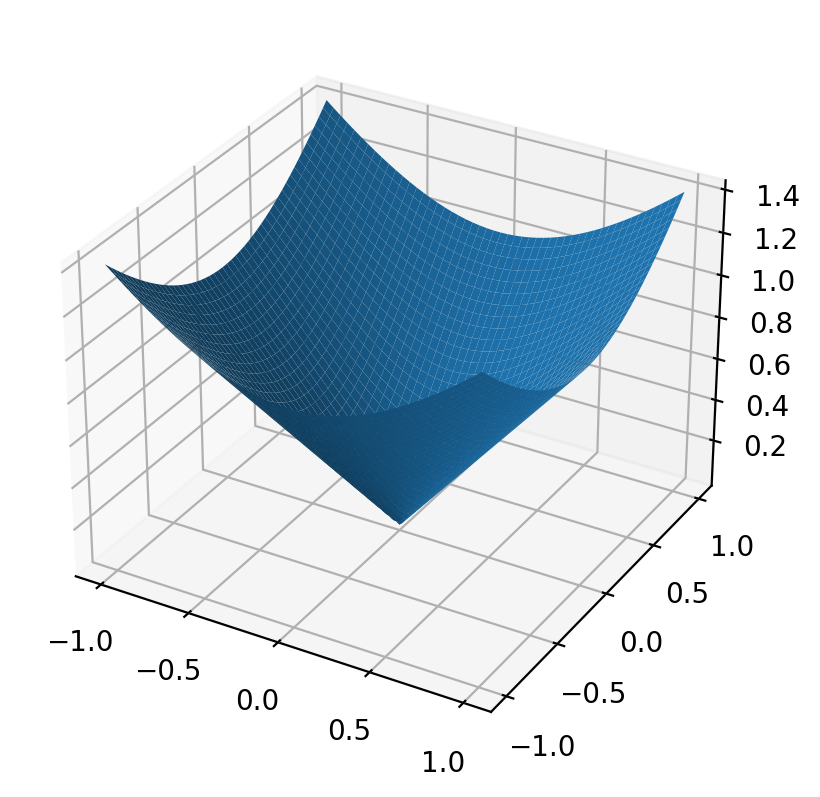

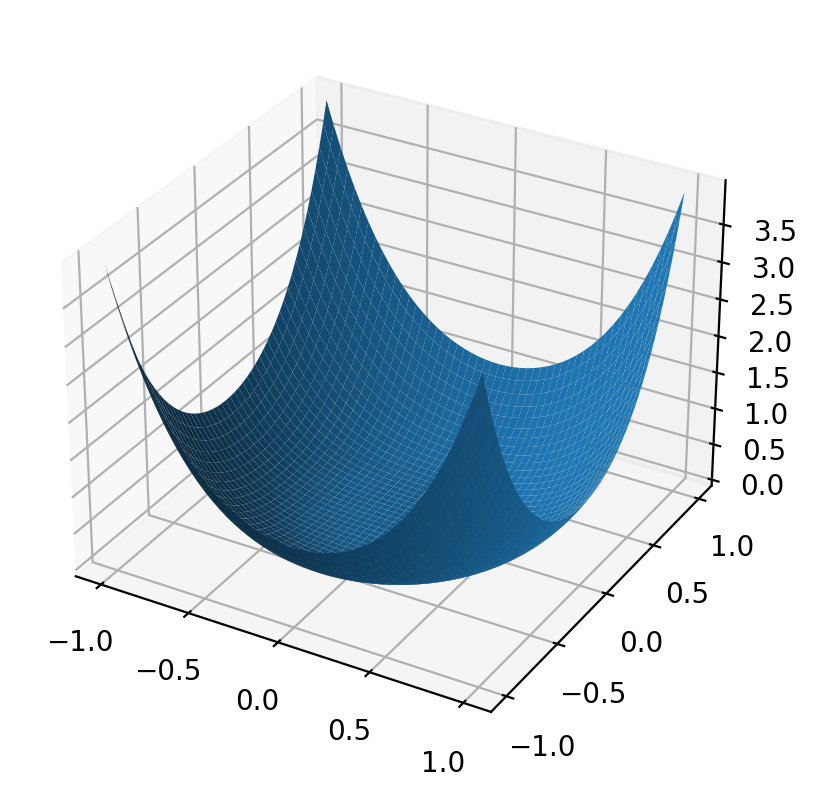

In [6]:
neuron_num = 2048
relu_k = 2 
my_model_1 = model(2,neuron_num,1,relu_k)
## non smooth 
filename = "model_cpu_OGA_2D_cone2d_relu2_neuron_2048_N_2048_randomized.pt"
# c = torch.load(filename)
# print(c)
my_model_1.load_state_dict(torch.load(filename))
plot_2D(my_model_1,[-1,-1],[1,1])


neuron_num = 2048
relu_k = 2 
my_model_2 = model(2,neuron_num,1,relu_k)

filename = "model_cpu_OGA_2D_quartic2d_relu2_neuron_2048_N_2048_randomized.pt"
# c = torch.load(filename)
# c 
my_model_2.load_state_dict(torch.load(filename))
plot_2D(my_model_2,[-1,-1],[1,1])

In [7]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots

def plot_front_back_views_x_filtered(points, 
                                     point_color='red', 
                                     point_size=1.5, 
                                     sphere_opacity=0.3,
                                     north_pole_color='green',
                                     south_pole_color='blue',
                                     pole_size=10,
                                     pole_symbol='diamond',
                                     renderer='browser'):
    """
    Plots the scattered points on a unit sphere from two viewpoints based on the x-coordinate:
    - "Front" view: points with x > 0.
    - "Back" view: points with x ≤ 0.
    The sphere surface and pole markers are included in both views.
    
    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points.
    - point_size (int): Size of the scatter points.
    - sphere_opacity (float): Opacity of the unit sphere surface.
    - north_pole_color (str): Color for the North Pole marker.
    - south_pole_color (str): Color for the South Pole marker.
    - pole_size (int): Size of the pole markers.
    - pole_symbol (str): Marker symbol for the poles.
    - renderer (str): Plotly renderer type (e.g., 'browser', 'notebook').
    """
    
    # Set Plotly renderer
    pio.renderers.default = renderer

    # Ensure points is a NumPy array with shape (N,3)
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")
    
    # Split points based on x-coordinate:
    front_points = points[points[:, 0] > 0]
    back_points  = points[points[:, 0] <= 0]

    # Generate coordinates for the unit sphere surface
    u = np.linspace(0, 2 * np.pi, 50)
    v = np.linspace(0, np.pi, 50)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface trace
    sphere_surface = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Create scatter trace for front points (x > 0)
    scatter_front = go.Scatter3d(
        x=front_points[:, 0],
        y=front_points[:, 1],
        z=front_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Front Points (x > 0)'
    )

    # Create scatter trace for back points (x <= 0)
    scatter_back = go.Scatter3d(
        x=back_points[:, 0],
        y=back_points[:, 1],
        z=back_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Back Points (x ≤ 0)'
    )

    # Define North and South Pole markers (shown in both views)
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Create a subplot with 1 row and 2 columns for front/back views
    fig = make_subplots(
        rows=1, cols=2,
        specs=[[{'type': 'scene'}, {'type': 'scene'}]],
        subplot_titles=["Front View (x > 0)", "Back View (x ≤ 0)"],
        horizontal_spacing=0.02
    )

    # Add traces for the front view (only front_points)
    fig.add_trace(sphere_surface, row=1, col=1)
    fig.add_trace(scatter_front, row=1, col=1)
    fig.add_trace(north_pole, row=1, col=1)
    fig.add_trace(south_pole, row=1, col=1)

    # Add traces for the back view (only back_points)
    fig.add_trace(sphere_surface, row=1, col=2)
    fig.add_trace(scatter_back, row=1, col=2)
    fig.add_trace(north_pole, row=1, col=2)
    fig.add_trace(south_pole, row=1, col=2)

    # Define camera views:
    # Front view: camera looking from the positive x direction.
    front_camera = dict(eye=dict(x=2, y=0, z=0))
    # Back view: camera looking from the negative x direction.
    back_camera  = dict(eye=dict(x=-2, y=0, z=0))

    # Update layout for each scene
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=front_camera,
            aspectmode='cube'
        ),
        scene2=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=back_camera,
            aspectmode='cube'
        ),
        title_text='Front and Back Views of Points on a Sphere (Filtered by x-coordinate)',
        width=1200,
        height=600
    )

    fig.show()


In [8]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

def plot_interactive_sphere(points, 
                            point_color='red', 
                            point_size=1.5, 
                            sphere_color='cyan', 
                            sphere_opacity=0.3,
                            north_pole_color='green',
                            south_pole_color='blue',
                            pole_size=10,
                            pole_symbol='diamond',
                            title='Interactive 3D Plot on Unit Sphere',
                            renderer='browser'):
    """
    Plots an interactive 3D scatter plot on a unit sphere, including the North and South Poles.

    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points. Default is 'red'.
    - point_size (int): Size of the scatter points. Default is 5.
    - sphere_color (str): Base color of the unit sphere. Default is 'cyan'.
    - sphere_opacity (float): Opacity of the sphere (0 to 1). Default is 0.3.
    - north_pole_color (str): Color of the North Pole marker. Default is 'green'.
    - south_pole_color (str): Color of the South Pole marker. Default is 'blue'.
    - pole_size (int): Size of the pole markers. Default is 10.
    - pole_symbol (str): Marker symbol for the poles. Default is 'diamond'.
    - title (str): Title of the plot. Default is 'Interactive 3D Plot on Unit Sphere'.
    - renderer (str): Plotly renderer type. Default is 'browser'.

    Returns:
    - None. Displays the interactive plot.
    """

    # Ensure points are a NumPy array
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")

    # Set Plotly renderer
    pio.renderers.default = renderer

    # Create scatter plot for the main points
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Scatter Points'
    )

    # Create unit sphere coordinates
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface
    sphere = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Define North Pole
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    # Define South Pole
    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Define layout
    layout = go.Layout(
        title=title,
        scene=dict(
            xaxis=dict(title='X-axis'),
            yaxis=dict(title='Y-axis'),
            zaxis=dict(title='Z-axis'),
            aspectmode='data'  # Ensures equal scaling
        ),
        width=800,
        height=700
    )

    # Create figure with all traces
    fig = go.Figure(data=[sphere, scatter, north_pole, south_pole], layout=layout)

    # Display the plot
    fig.show()


w = my_model_1.fc1.weight.data 
b = my_model_1.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')
plot_front_back_views_x_filtered(w_b,renderer='notebook')

w = my_model_2.fc1.weight.data 
b = my_model_2.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')

plot_front_back_views_x_filtered(w_b,renderer='notebook')



### arctan example data

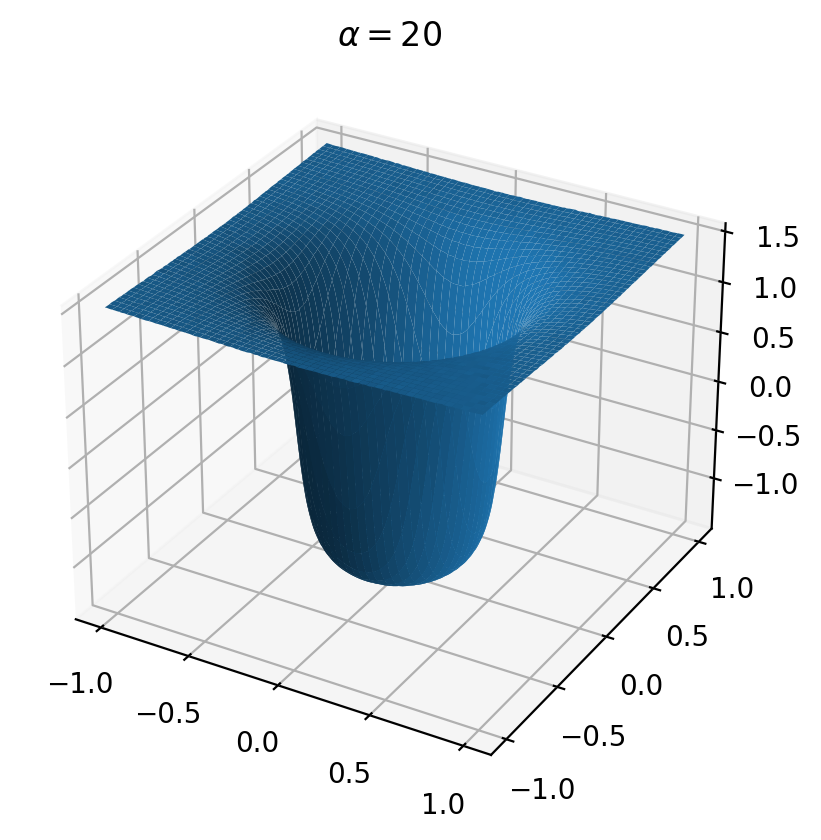

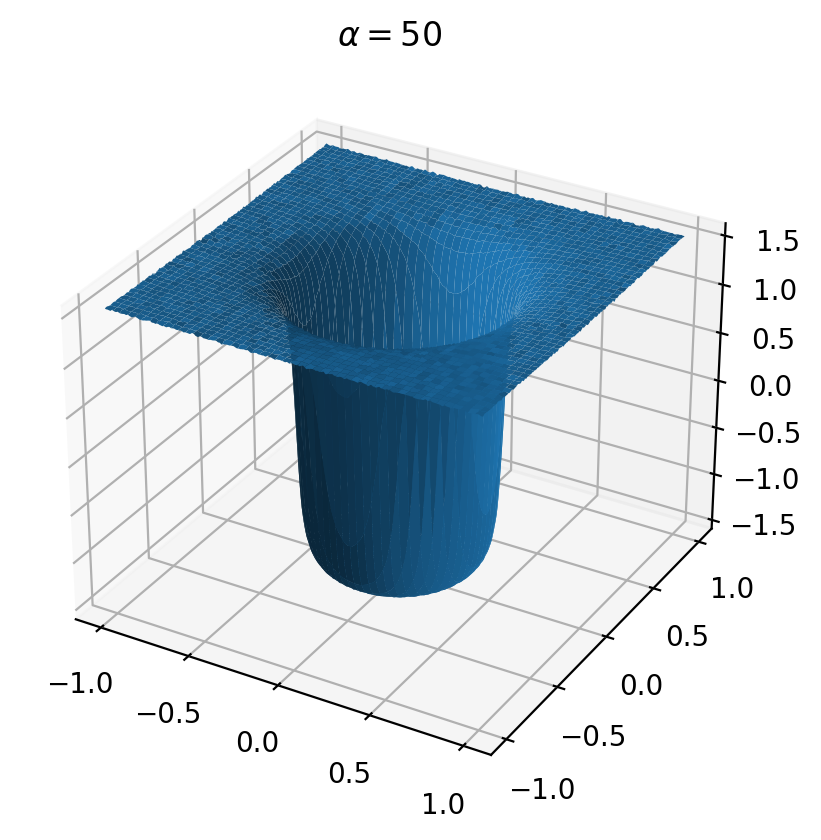

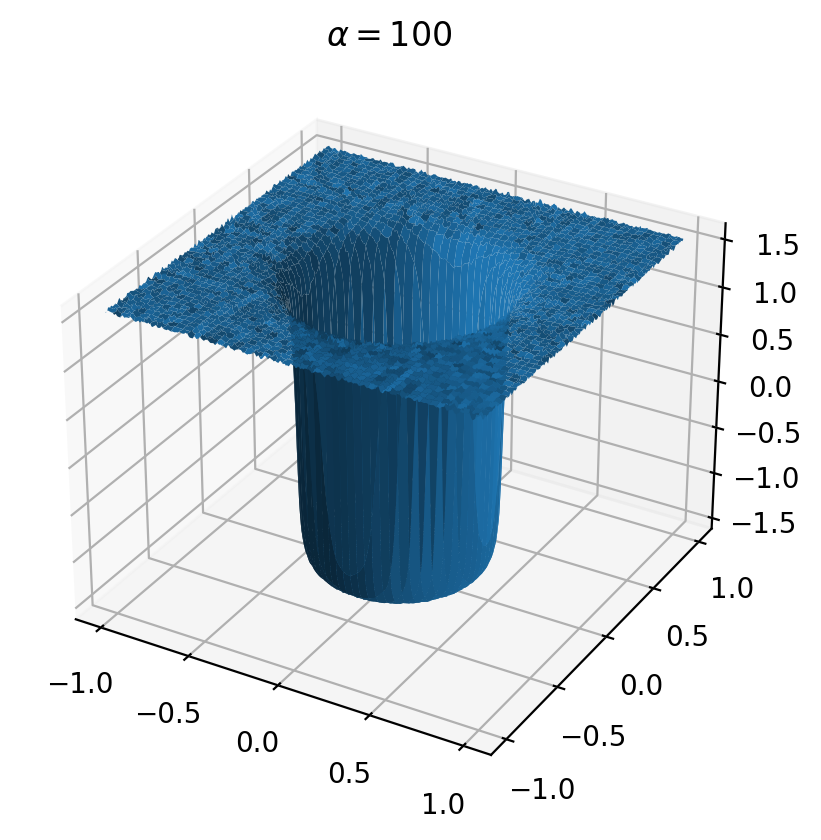

In [9]:
neuron_num = 2048
relu_k = 1 
my_model_1 = model(2,neuron_num,1,relu_k)
## non smooth 
filename = "model_cpu_OGA_2D_atan2d-20_relu1_neuron_2048_N_4096_randomized.pt"
# c = torch.load(filename)
# print(c)
my_model_1.load_state_dict(torch.load(filename))
plot_2D(my_model_1,[-1,-1],[1,1],name="$\\alpha = 20$")

neuron_num = 2048
relu_k = 1 
my_model_2 = model(2,neuron_num,1,relu_k)
## non smooth 
filename = "model_cpu_OGA_2D_atan2d-50_relu1_neuron_2048_N_4096_randomized.pt"
# c = torch.load(filename)
# print(c)
my_model_2.load_state_dict(torch.load(filename))
plot_2D(my_model_2,[-1,-1],[1,1],name="$\\alpha = 50$")

neuron_num = 2048
relu_k = 1 
my_model_3 = model(2,neuron_num,1,relu_k)
## non smooth 
filename = "model_cpu_OGA_2D_atan2d-100_relu1_neuron_2048_N_4096_randomized.pt"
# c = torch.load(filename)
# print(c)
my_model_3.load_state_dict(torch.load(filename))
plot_2D(my_model_3,[-1,-1],[1,1],name="$\\alpha = 100$")



## plotting the cutting hyperplanes 


In [23]:
import numpy as np
import torch
import matplotlib.pyplot as plt

def plot_relu_hyperplanes(W, b, domain=(-1, 1)):
    """
    Plot every cutting hyperplane w1*x + w2*y + b = 0 produced by the first
    layer of a 2-D shallow ReLU network on the square (xmin,xmax)^2.

    Parameters
    ----------
    W : (m, 2) torch.Tensor or np.ndarray
        First-layer weight matrix (one row per hidden neuron).
    b : (m,) torch.Tensor or np.ndarray
        First-layer biases.
    domain : tuple (xmin, xmax), optional
        Square domain corners; default is (-1, 1).

    Notes
    -----
    * Unused neurons: if both weights and bias are (close to) zero the line
      degenerates and is skipped.
    * No external dependencies beyond matplotlib & numpy/torch.
    """
    # --- ensure numpy arrays ----------------------------------------------
    W = W.detach().cpu().numpy() if isinstance(W, torch.Tensor) else np.asarray(W)
    b = b.detach().cpu().numpy() if isinstance(b, torch.Tensor) else np.asarray(b)
    xmin, xmax = domain
    ymin, ymax = domain

    segments = []

    for (w1, w2), bi in zip(W, b):
        if np.allclose([w1, w2], 0, atol=1e-12):   # neuron never activates
            continue

        pts = []  # collect candidate intersections inside the square

        # Intersect with the four edges
        if abs(w2) > 1e-12:        # vertical edges: x = xmin, xmax
            for x in (xmin, xmax):
                y = -(w1 * x + bi) / w2
                if ymin - 1e-12 <= y <= ymax + 1e-12:
                    pts.append((x, y))

        if abs(w1) > 1e-12:        # horizontal edges: y = ymin, ymax
            for y in (ymin, ymax):
                x = -(w2 * y + bi) / w1
                if xmin - 1e-12 <= x <= xmax + 1e-12:
                    pts.append((x, y))

        # keep unique points only
        if len(pts) >= 2:
            # possible duplicates from touching corners
            p_unique = np.unique(np.round(pts, 12), axis=0)
            if p_unique.shape[0] >= 2:
                # choose the two extreme points (longest segment in square)
                # sort by x then y for reproducibility
                p_sorted = p_unique[np.lexsort((p_unique[:,1], p_unique[:,0]))]
                segments.append(p_sorted[[0, -1]])

    # --- plotting ----------------------------------------------------------
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                               fill=False, linewidth=2))
    for seg in segments:
        ax.plot(seg[:, 0], seg[:, 1], linewidth=1)

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_aspect("equal")
    ax.set_xlabel(r"$x$")
    ax.set_ylabel(r"$y$")
    ax.set_title("Cutting planes of shallow ReLU network, n = {}".format(W.shape[0]))
    plt.show()


In [11]:
import numpy as np, torch, random, matplotlib.pyplot as plt
from shapely.geometry import LineString, Polygon, box
from shapely.ops import polygonize

def plot_relu_regions(
        W, b, *,
        domain=(-1., 1.),
        max_neurons=60,        # keep it tractable: O(m²) line intersections
        weight_thresh=None,    # ignore “dead” neurons if you have output weights
        out_w=None,
        rng_seed=0,
        edge_lw=0.4,
        alpha=0.95,
        figsize=(6, 6)):
    """
    Visualise every distinct linear region of a 2-input shallow ReLU net.

    Parameters
    ----------
    W : (m, 2)  torch.Tensor | np.ndarray
        First-layer weights.
    b : (m,)    torch.Tensor | np.ndarray
        First-layer biases.
    domain : (xmin, xmax)
        Square domain (same limits on x and y).
    max_neurons : int
        Hard cap on the number of neurons to keep (combinatorics explodes!).
    weight_thresh : float | None
        If set, neurons with |out_w| < thresh are discarded.
    out_w : (m,) torch.Tensor | np.ndarray | None
        Output weights (needed only if you want to filter by importance).
    rng_seed : int
        For reproducible random colours.
    """
    # ---------- to NumPy ---------------------------------------------------
    W = W.detach().cpu().numpy() if isinstance(W, torch.Tensor) else np.asarray(W)
    b = b.detach().cpu().numpy() if isinstance(b, torch.Tensor) else np.asarray(b)
    if out_w is not None:
        out_w = out_w.detach().cpu().numpy() if isinstance(out_w, torch.Tensor) else np.asarray(out_w)

    # ---------- optional importance filtering ------------------------------
    idx = np.arange(len(b))
    if (weight_thresh is not None) and (out_w is not None):
        idx = idx[np.abs(out_w) > weight_thresh]
    if len(idx) > max_neurons:
        # keep the strongest `max_neurons` (or random pick if no out_w)
        if out_w is None:
            idx = np.random.choice(idx, size=max_neurons, replace=False)
        else:
            idx = idx[np.argsort(np.abs(out_w[idx]))[-max_neurons:]]

    xmin, xmax = domain
    ymin, ymax = domain
    square = box(xmin, ymin, xmax, ymax)

    # ---------- build the arrangement’s line segments ----------------------
    segments = []
    for i in idx:
        w1, w2 = W[i]
        bi     = b[i]
        pts    = []

        # left/right edges   (x = xmin/xmax)
        if abs(w2) > 1e-12:
            for x in (xmin, xmax):
                y = -(w1 * x + bi) / w2
                if ymin - 1e-12 <= y <= ymax + 1e-12:
                    pts.append((x, y))
        # bottom/top edges   (y = ymin/ymax)
        if abs(w1) > 1e-12:
            for y in (ymin, ymax):
                x = -(w2 * y + bi) / w1
                if xmin - 1e-12 <= x <= xmax + 1e-12:
                    pts.append((x, y))

        if len(pts) >= 2:
            # remove duplicate corner hits
            p = np.unique(np.round(pts, 12), axis=0)
            if len(p) >= 2:
                segments.append(LineString(p[[0, -1]]))

    # add the four boundary edges so polygonise closes everything
    bx, by = [xmin, xmin, xmax, xmax, xmin], [ymin, ymax, ymax, ymin, ymin]
    boundary = LineString(np.c_[bx, by])
    all_lines = segments + [boundary]

    # ---------- polygonise -------------------------------------------------
    polys = list(polygonize(all_lines))

    # ---------- colour map by activation pattern --------------------------
    random.seed(rng_seed)
    pattern_to_colour = {}
    face_colours      = []

    for poly in polys:
        cx, cy = poly.representative_point().coords[0]
        pattern = tuple(((W[idx] @ np.array([cx, cy]) + b[idx]) > 0).astype(int))

        if pattern not in pattern_to_colour:
            # new pattern ⇒ assign a random bright colour
            colour = (random.random()*0.8 + 0.2,
                      random.random()*0.8 + 0.2,
                      random.random()*0.8 + 0.2)
            pattern_to_colour[pattern] = colour
        face_colours.append(pattern_to_colour[pattern])

    # ---------- draw -------------------------------------------------------
    fig, ax = plt.subplots(figsize=figsize)
    for poly, fc in zip(polys, face_colours):
        x, y = poly.exterior.xy
        ax.fill(x, y, facecolor=fc, edgecolor='k', lw=edge_lw, alpha=alpha)

    ax.set_xlim(xmin, xmax);  ax.set_ylim(ymin, ymax)
    ax.set_aspect('equal')
    ax.set_xlabel('$x$'); ax.set_ylabel('$y$')
    ax.set_title('Distinct Linear Regions of a Shallow ReLU Network')
    plt.tight_layout()
    plt.show()


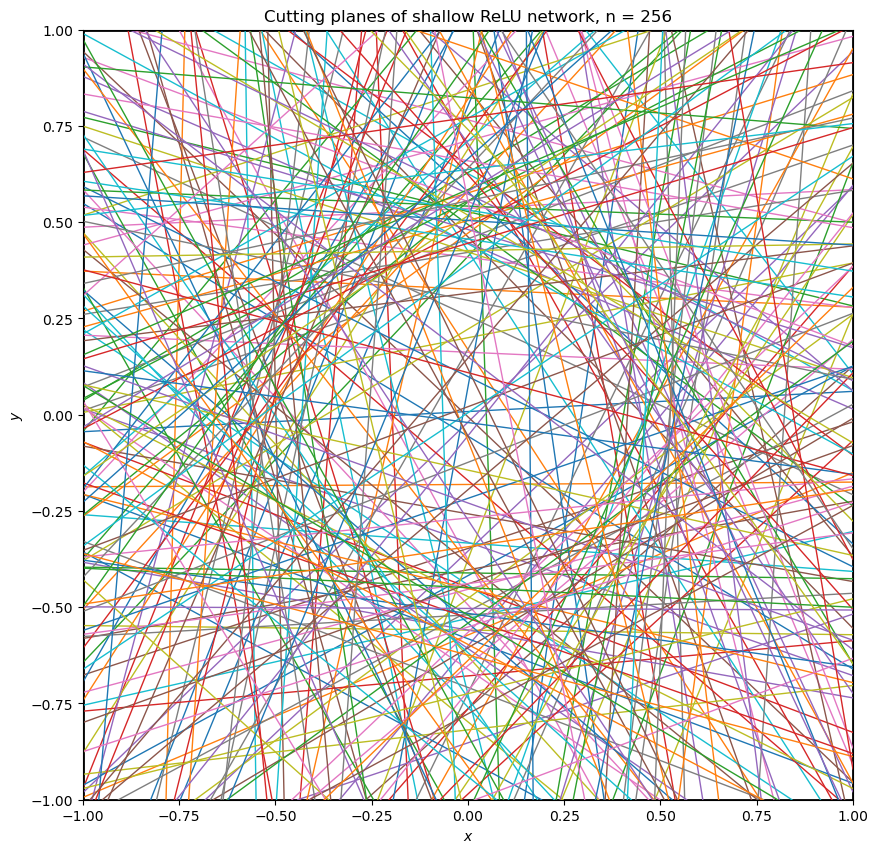

In [24]:
selected_neurons = 256
w = my_model_1.fc1.weight.data[:selected_neurons, :2] 
b = my_model_1.fc1.bias.data[:selected_neurons]
plot_relu_hyperplanes(w, b)

# plot_relu_regions(w, b, max_neurons=512, weight_thresh=0.01, out_w=my_model_1.fc2.weight.data[:,0], domain=(-1, 1), figsize=(10, 10))

In [ ]:
w = my_model_1.fc1.weight.data 
b = my_model_1.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')
plot_front_back_views_x_filtered(w_b,renderer='notebook')

w = my_model_2.fc1.weight.data 
b = my_model_2.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')
plot_front_back_views_x_filtered(w_b,renderer='notebook')

w = my_model_3.fc1.weight.data
b = my_model_3.fc1.bias.data
w_b = torch.cat((w,b.reshape(-1,1)),1)
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook')
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')
plot_front_back_views_x_filtered(w_b,renderer='notebook')